In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score

(np.float64(-0.5), np.float64(999.5), np.float64(959.5), np.float64(-0.5))

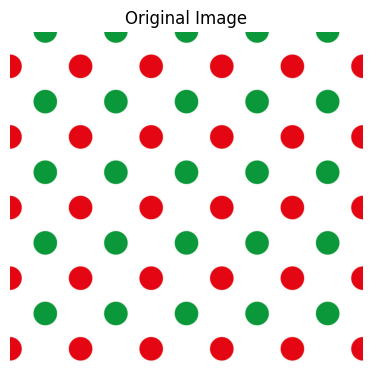

In [ ]:
image = cv2.imread("/content/red.PNG")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image)
plt.axis("off")

In [ ]:
pixels = image.reshape(-1, 3)

In [ ]:
scaler = MinMaxScaler()
pixels_scaled = scaler.fit_transform(pixels)


In [ ]:
pixels_scaled
len(pixels_scaled)

960000

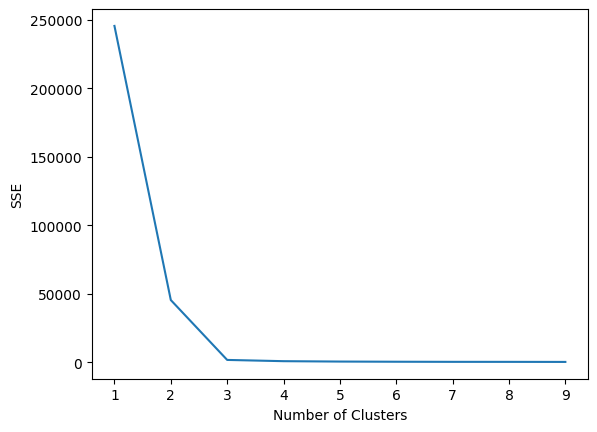

In [ ]:
sse = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(pixels_scaled)
    sse.append(kmeans.inertia_)

#visualize results
plt.plot(range(1, 10), sse)
plt.xticks(range(1, 10))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

In [ ]:
k=3
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
kmeans.fit(pixels_scaled)

KMeans(n_clusters=3, n_init=10, random_state=42)

In [ ]:
image.shape

(960, 1000, 3)

In [ ]:
kmeans.labels_

array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

In [ ]:
segmented_pixels = kmeans.cluster_centers_[kmeans.labels_]
segmented_pixels = scaler.inverse_transform(segmented_pixels)  # Rescale to original range
segmented_image = segmented_pixels.reshape(image.shape)

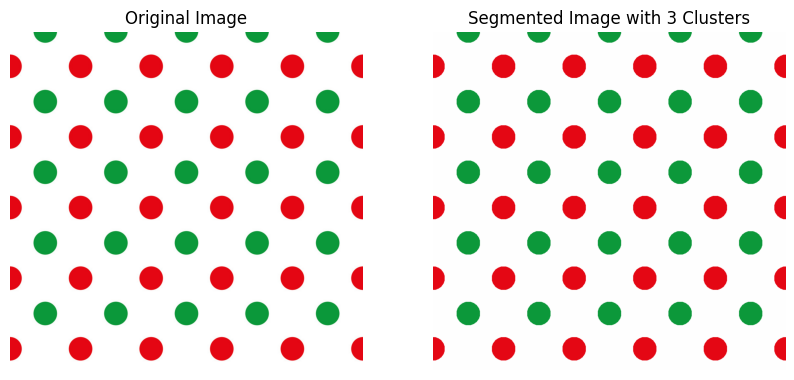

In [ ]:
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title(f"Segmented Image with {k} Clusters")
plt.imshow(segmented_image.astype(np.uint8))
plt.axis("off")

plt.show()

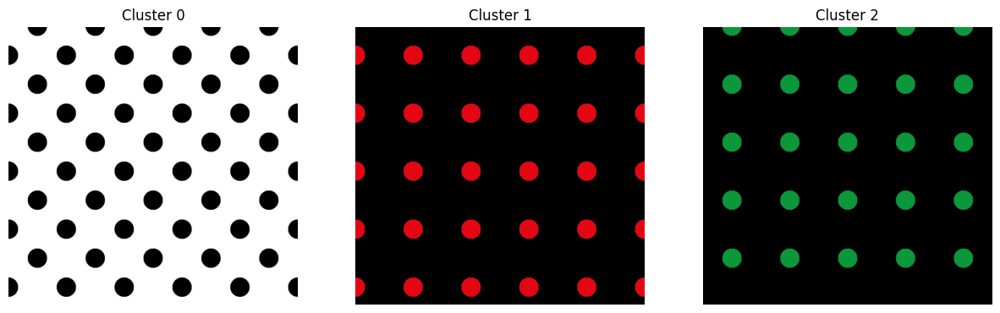

In [ ]:
pixels = image.reshape(-1, 3)


scaler = MinMaxScaler()
pixels_scaled = scaler.fit_transform(pixels)

k = 3
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
kmeans.fit(pixels_scaled)


labels = kmeans.labels_


fig, axes = plt.subplots(1, k, figsize=(15, 5))

for cluster_id in range(k):
    cluster_image = np.zeros_like(pixels)
    cluster_image[labels == cluster_id] = pixels[labels == cluster_id]
    cluster_image = cluster_image.reshape(image.shape)
    axes[cluster_id].imshow(cluster_image)
    axes[cluster_id].set_title(f"Cluster {cluster_id}")
    axes[cluster_id].axis("off")

plt.show()

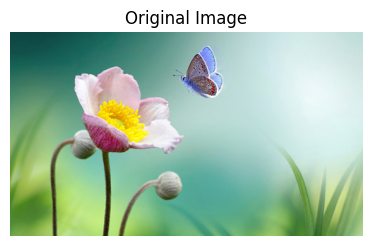

In [ ]:
image = cv2.imread("/content/test.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image)
plt.axis("off")
pixels = image.reshape(-1, 3)
scaler = MinMaxScaler()
pixels_scaled = scaler.fit_transform(pixels)


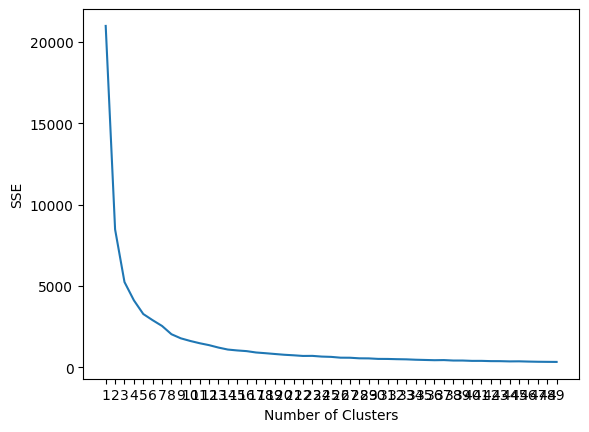

In [ ]:
sse = []
for k in range(1, 50):
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(pixels_scaled)
    sse.append(kmeans.inertia_)

#visualize results
plt.plot(range(1, 50), sse)
plt.xticks(range(1, 50))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

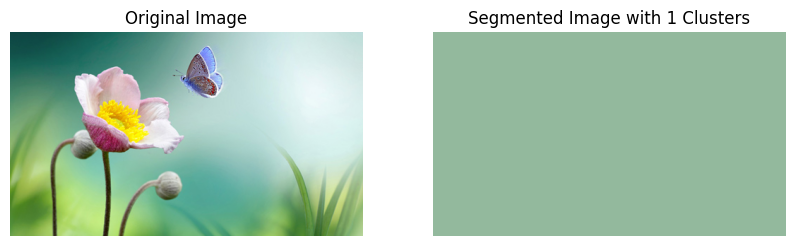

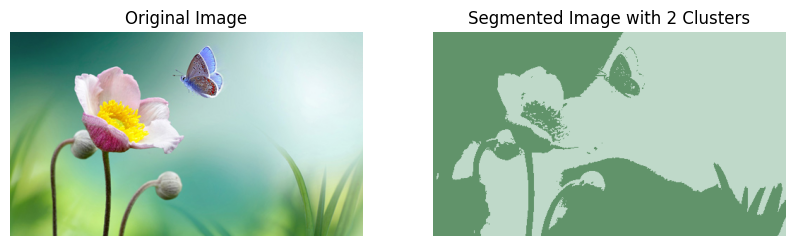

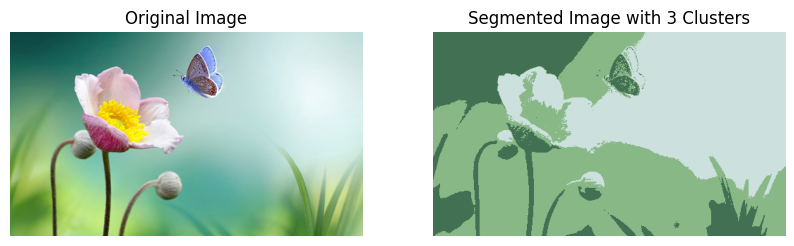

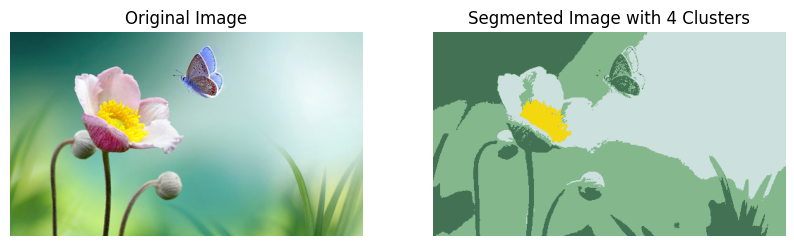

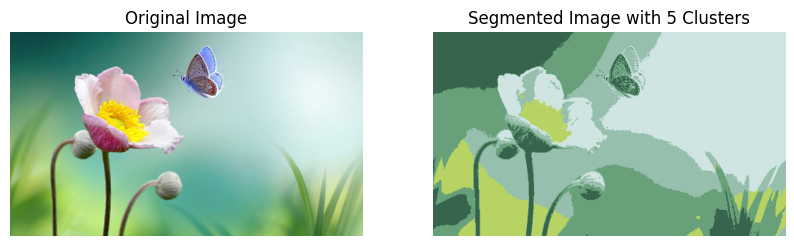

...

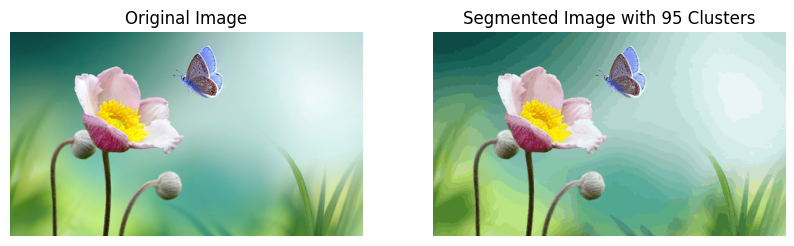

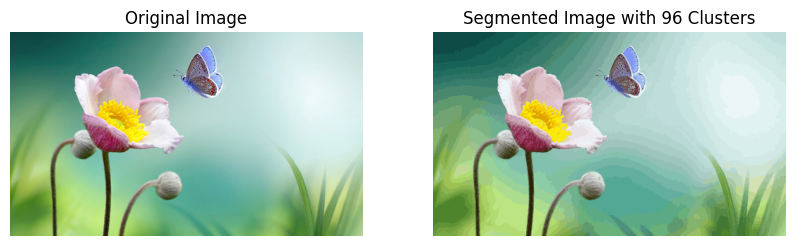

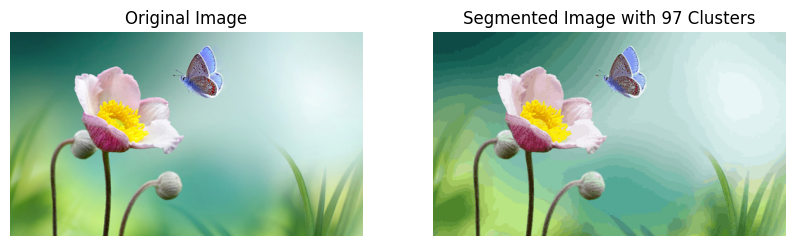

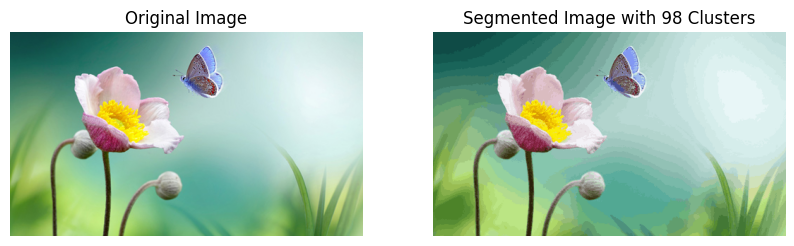

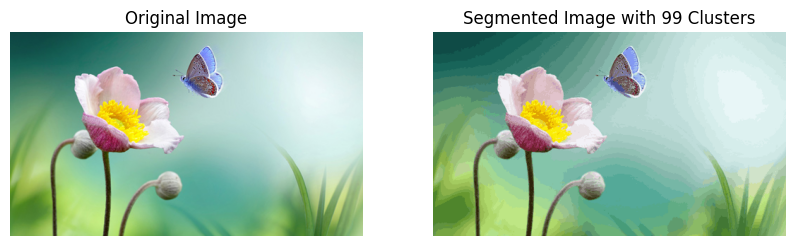

In [ ]:
for k in range(1, 100):
  kmeans = KMeans(n_clusters=k)
  kmeans.fit(pixels_scaled)
  segmented_pixels = kmeans.cluster_centers_[kmeans.labels_]
  segmented_pixels = scaler.inverse_transform(segmented_pixels)  # Rescale to original range
  segmented_image = segmented_pixels.reshape(image.shape)
  plt.figure(figsize=(10, 5))
  plt.subplot(1, 2, 1)
  plt.title("Original Image")
  plt.imshow(image)
  plt.axis("off")

  plt.subplot(1, 2, 2)
  plt.title(f"Segmented Image with {k} Clusters")
  plt.imshow(segmented_image.astype(np.uint8))
  plt.axis("off")

  plt.show()
